In [1]:
import pandas as pd
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats

In [2]:
df=pd.read_csv('horserace_EDA.csv')
df

,race_id,horse_no,horse_id,result,won,lengths_behind,horse_age,horse_country,horse_type,horse_rating,...,year,month,day,total_wins,win_rate_jockey,win_rate_trainer,horse_jockey_pair,win_rate,avg_finish_position,finish_time_trend
0,0,1,3917,10,0,8.00,3,AUS,Gelding,60,...,1997,6,Monday,2,0.149523,0.140768,3917_2,0.222222,7.566667,0.342868
1,0,2,2157,8,0,5.75,3,NZ,Gelding,60,...,1997,6,Monday,2,0.088795,0.083400,2157_57,0.000000,7.937500,0.348990
2,0,3,858,7,0,4.75,3,NZ,Gelding,60,...,1997,6,Monday,2,0.124434,0.097674,858_18,0.000000,5.681818,0.120649
3,0,4,1853,9,0,6.25,3,SAF,Gelding,60,...,1997,6,Monday,0,0.092593,0.084547,1853_59,0.000000,8.857143,3.214643
4,0,5,2796,6,0,3.75,3,GB,Gelding,60,...,1997,6,Monday,0,0.056800,0.056887,2796_154,0.000000,5.500000,1.413147
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79280,6348,10,1238,6,0,1.25,5,AUS,Gelding,87,...,2005,8,Sunday,3,0.060181,0.083534,1238_40,0.285714,4.538462,0.353306
79281,6348,11,985,7,0,2.25,5,NZ,Gelding,84,...,2005,8,Sunday,2,0.053220,0.083400,985_63,0.000000,5.482759,0.756591
79282,6348,12,3147,10,0,3.00,5,NZ,Gelding,83,...,2005,8,Sunday,1,0.045198,0.085007,3147_68,0.000000,5.071429,1.674747
79283,6348,13,1982,8,0,2.50,3,AUS,Gelding,82,...,2005,8,Sunday,1,0.235056,0.140768,1982_95,0.500000,4.500000,27.050000


In [3]:
df.isnull().mean()*100

race_id                0.000000
horse_no               0.000000
horse_id               0.000000
result                 0.000000
won                    0.000000
                         ...   
win_rate_trainer       0.000000
horse_jockey_pair      0.000000
win_rate               0.000000
avg_finish_position    0.000000
finish_time_trend      0.488113
Length: 82, dtype: float64

In [4]:
## Drop columns that have above 40% null values 
df.drop(['position_sec4','position_sec5','position_sec6','behind_sec4','behind_sec5','behind_sec6','time4runs','time5runs','time6runs','sec_time4','sec_time5' ,'sec_time6','time4race','time5race','time6race','place_combination4','place_dividend4','win_combination2','win_dividend2'],axis=1,inplace=True)
## Drop Identifiers and Unique Columns
df.drop(['horse_id', 'race_id'],axis=1,inplace=True)
## Drop highly Correlated Features
df.drop(['place_odds','position_sec2','behind_sec1','behind_sec2','weight_difference','distance','place_combination1'],axis=1,inplace=True)
## Drop columns that haven't value in the model
df.drop(['horse_no','race_no'],axis=1,inplace=True)
## Drop columns that will cheat the model 
df.drop(['result','lengths_behind','finish_time','win_odds','position_sec1','position_sec3',
         'behind_sec3','time1runs', 'time2runs', 'time3runs','sec_time1', 'sec_time2', 'sec_time3',
         'time1race', 'time2race', 'time3race', 'place_combination2', 'place_combination3',
         'place_dividend1', 'place_dividend2', 'place_dividend3','win_combination1','win_dividend1','prize'],axis=1,inplace=True)
## Drop date column becouse i already extract year, month and day
df.drop(['date'],axis=1,inplace=True)

In [5]:
df

,won,horse_age,horse_country,horse_type,horse_rating,horse_gear,declared_weight,actual_weight,draw,trainer_id,...,year,month,day,total_wins,win_rate_jockey,win_rate_trainer,horse_jockey_pair,win_rate,avg_finish_position,finish_time_trend
0,0,3,AUS,Gelding,60,--,1020.0,133,7,118,...,1997,6,Monday,2,0.149523,0.140768,3917_2,0.222222,7.566667,0.342868
1,0,3,NZ,Gelding,60,--,980.0,133,12,164,...,1997,6,Monday,2,0.088795,0.083400,2157_57,0.000000,7.937500,0.348990
2,0,3,NZ,Gelding,60,--,1082.0,132,8,137,...,1997,6,Monday,2,0.124434,0.097674,858_18,0.000000,5.681818,0.120649
3,0,3,SAF,Gelding,60,--,1118.0,127,13,80,...,1997,6,Monday,0,0.092593,0.084547,1853_59,0.000000,8.857143,3.214643
4,0,3,GB,Gelding,60,--,972.0,131,14,9,...,1997,6,Monday,0,0.056800,0.056887,2796_154,0.000000,5.500000,1.413147
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79280,0,5,AUS,Gelding,87,TT/V,1191.0,122,6,73,...,2005,8,Sunday,3,0.060181,0.083534,1238_40,0.285714,4.538462,0.353306
79281,0,5,NZ,Gelding,84,--,1070.0,119,4,164,...,2005,8,Sunday,2,0.053220,0.083400,985_63,0.000000,5.482759,0.756591
79282,0,5,NZ,Gelding,83,H/XB,1148.0,120,1,111,...,2005,8,Sunday,1,0.045198,0.085007,3147_68,0.000000,5.071429,1.674747
79283,0,3,AUS,Gelding,82,--,1266.0,119,12,118,...,2005,8,Sunday,1,0.235056,0.140768,1982_95,0.500000,4.500000,27.050000


In [6]:
df.isnull().sum()

won                      0
horse_age                0
horse_country            2
horse_type               2
horse_rating             0
horse_gear               0
declared_weight          0
actual_weight            0
draw                     0
trainer_id               0
jockey_id                0
venue                    0
config                   0
surface                  0
going                    0
horse_ratings            0
race_class               0
year                     0
month                    0
day                      0
total_wins               0
win_rate_jockey          0
win_rate_trainer         0
horse_jockey_pair        0
win_rate                 0
avg_finish_position      0
finish_time_trend      387
dtype: int64

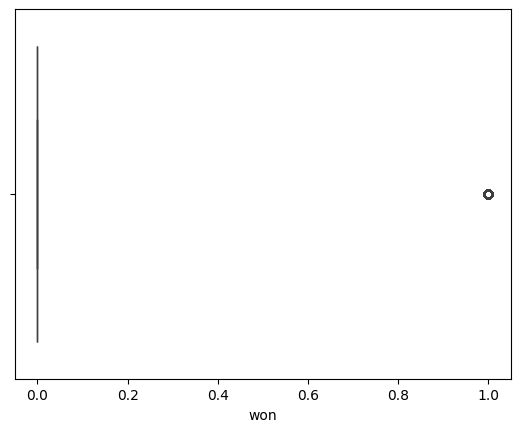

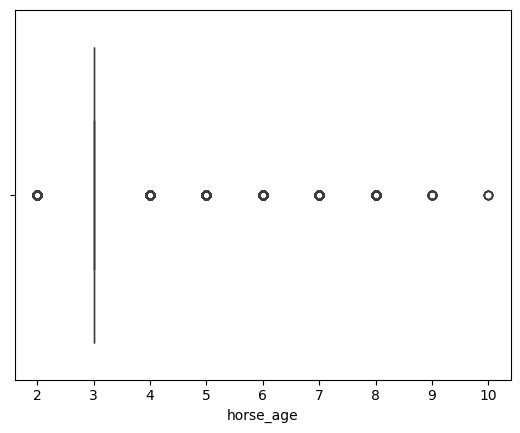

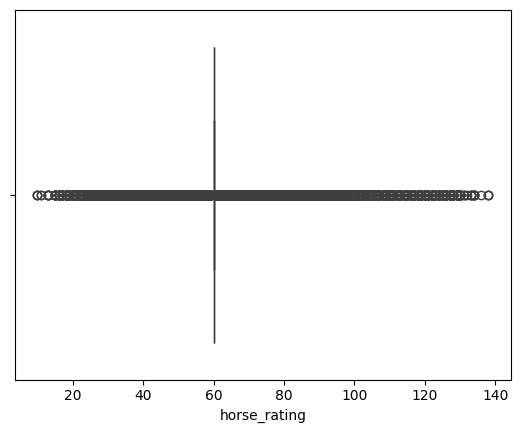

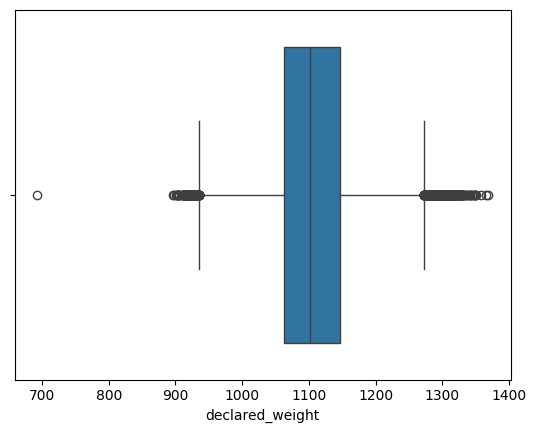

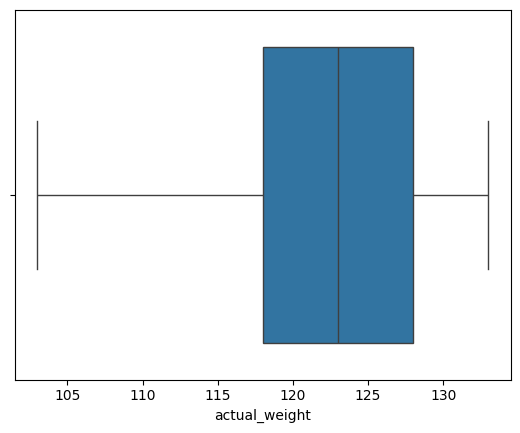

...

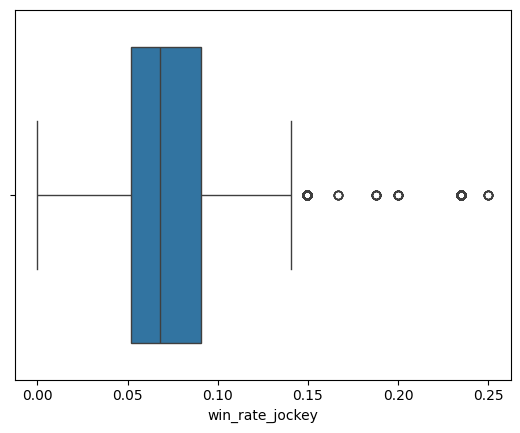

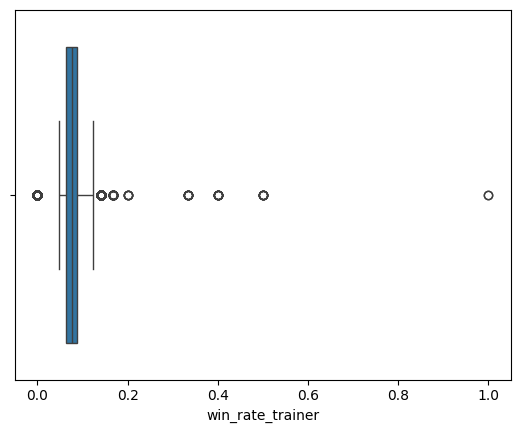

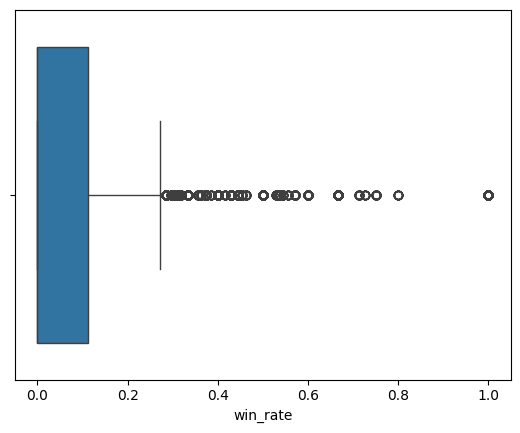

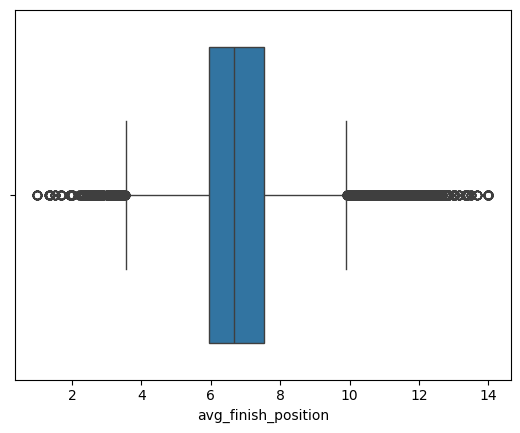

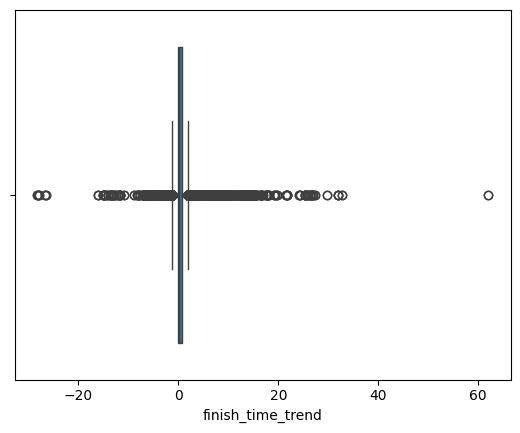

In [7]:
for col in df.select_dtypes('number').columns:
    plt.figure()
    sns.boxplot(x=df[col])

In [8]:
df['horse_age'].value_counts()

horse_age
3     61067
4      8004
5      4773
6      2241
2      2091
7       837
8       225
9        41
10        6
Name: count, dtype: int64

In [9]:
## We should drop age 2,6,7,8,9 and 10 becouse they have lower instance compare to other ages
df.drop(df[df['horse_age'].isin([2, 6, 7, 8, 9, 10])].index,axis=0,inplace=True)

In [10]:
px.box(df,x=df['horse_rating'])

In [11]:
df['horse_rating'].corr(df['won'])

0.01847381978104667

In [12]:
## This is very low correlation so we will drop horse rating and horse ratings column
df.drop(['horse_ratings','horse_rating'],axis=1,inplace=True)

In [13]:
px.box(df,x='declared_weight')

In [14]:
df.drop(df[df['declared_weight']==693].index,axis=0,inplace=True)

In [15]:
px.box(df,x=df['declared_weight'])

In [16]:
df['declared_weight'].corr(df['won'])

0.02851415690398931

In [17]:
# Since there’s little correlation with win, it’s likely not providing valuable predictive power. 
# Removing it could simplify your model and may reduce noise.
df.drop(['declared_weight'],axis=1,inplace=True)

<Axes: xlabel='surface', ylabel='Count'>

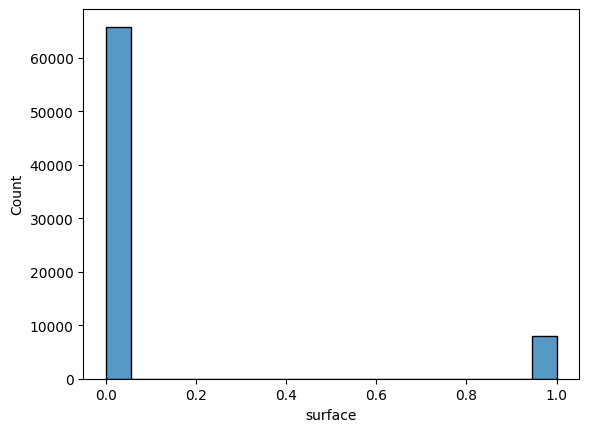

In [18]:
sns.histplot(df,x='surface')

In [19]:
df['surface'].corr(df['won'])

0.0004636507242822083

In [20]:
## No correlation
df.drop(['surface'],axis=1,inplace=True)

In [21]:
## Algorithms like tree-based models (Random Forest, XGBoost) can handle imbalances effectively.

In [22]:
px.box(x=np.log1p(df['race_class']))

In [23]:
df['race_class'].value_counts()

race_class
4     27091
3     23310
5     10728
2      6695
1      2547
11     1343
13     1082
12      560
6       385
0       102
Name: count, dtype: int64

In [24]:
correlation = df['race_class'].corr(df['won'])
print(f"Correlation: {correlation}")

Correlation: 0.0026991917079861494


In [25]:
## I think we should drop the race class becouse it is very weak correltion between them and the target and have much noise
df.drop('race_class',axis=1,inplace=True)

In [26]:
df.columns

Index(['won', 'horse_age', 'horse_country', 'horse_type', 'horse_gear',
       'actual_weight', 'draw', 'trainer_id', 'jockey_id', 'venue', 'config',
       'going', 'year', 'month', 'day', 'total_wins', 'win_rate_jockey',
       'win_rate_trainer', 'horse_jockey_pair', 'win_rate',
       'avg_finish_position', 'finish_time_trend'],
      dtype='object')

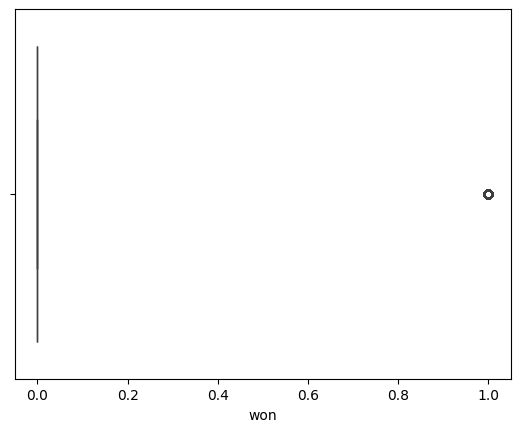

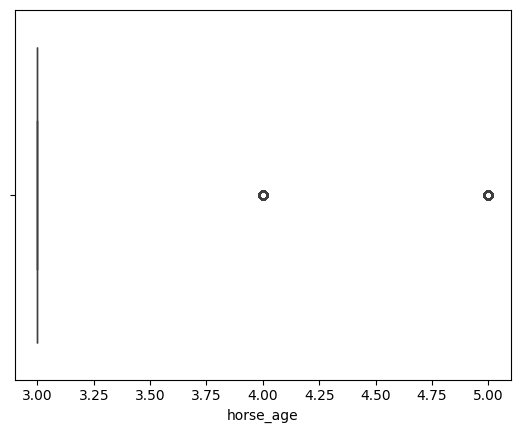

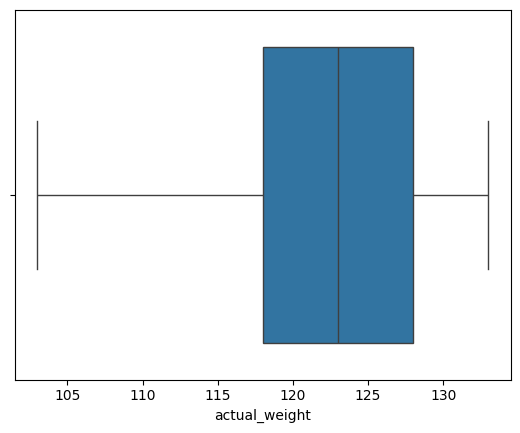

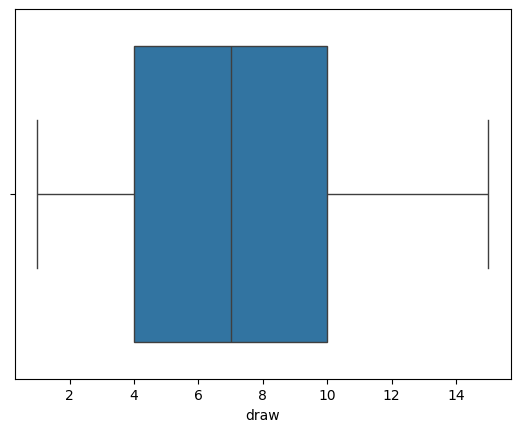

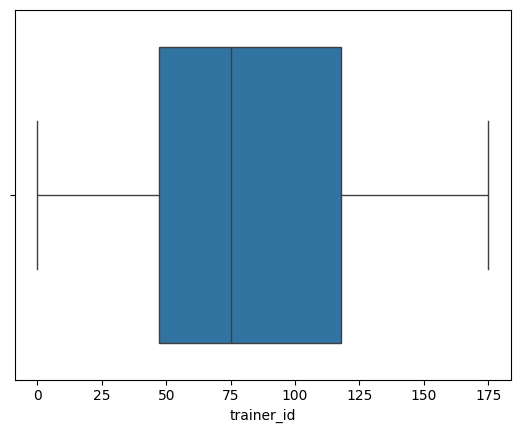

...

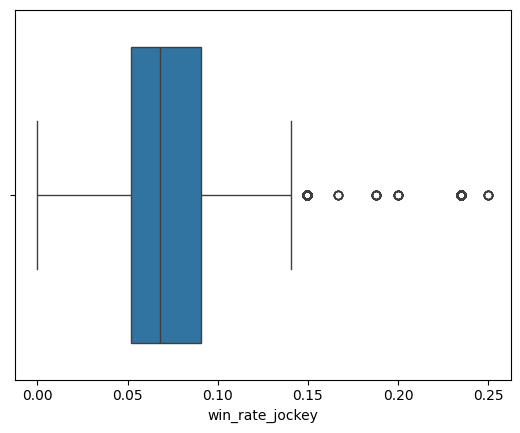

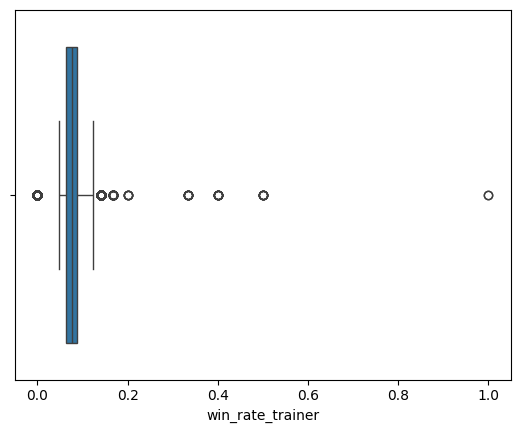

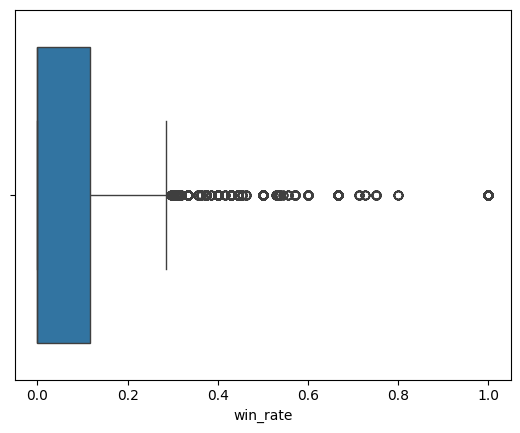

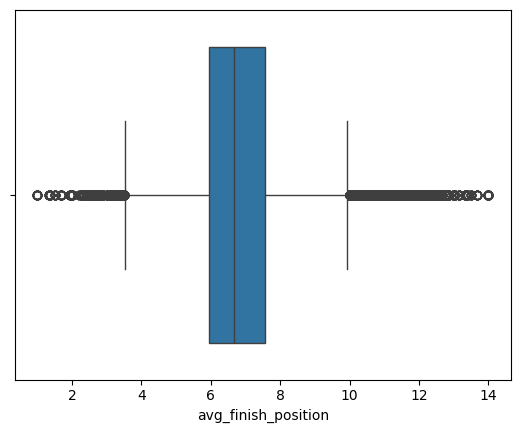

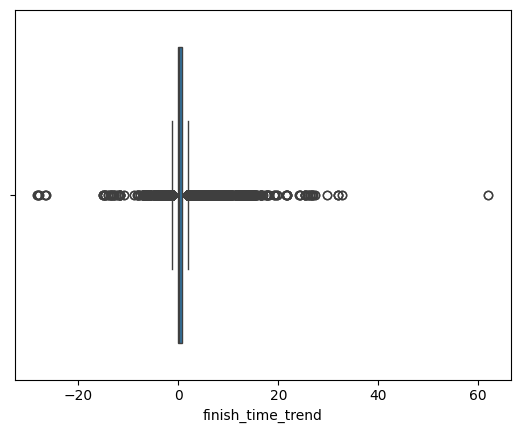

In [27]:
for col in df.select_dtypes('number').columns:
    plt.figure()
    sns.boxplot(x=df[col])

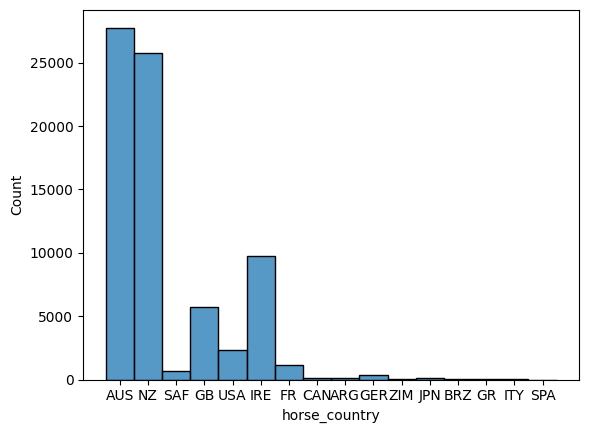

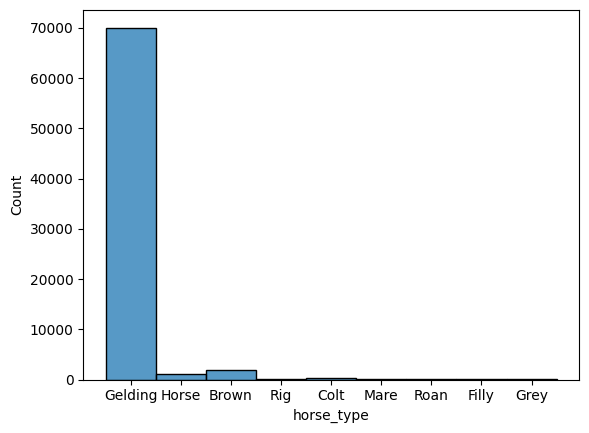

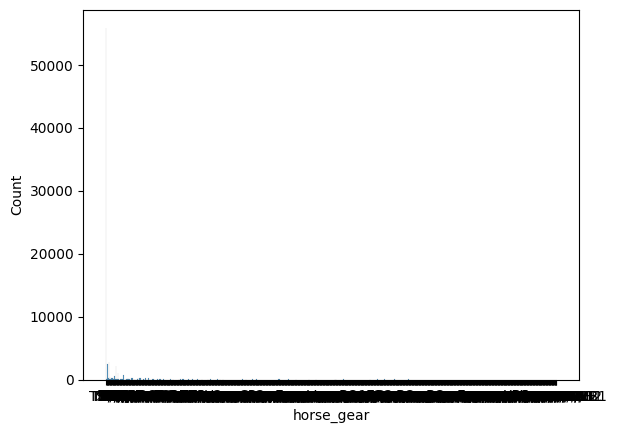

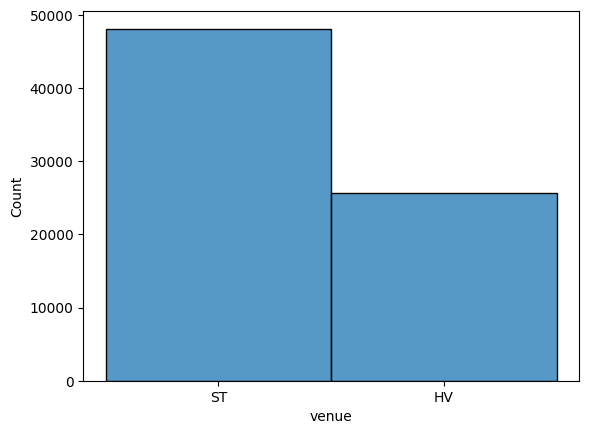

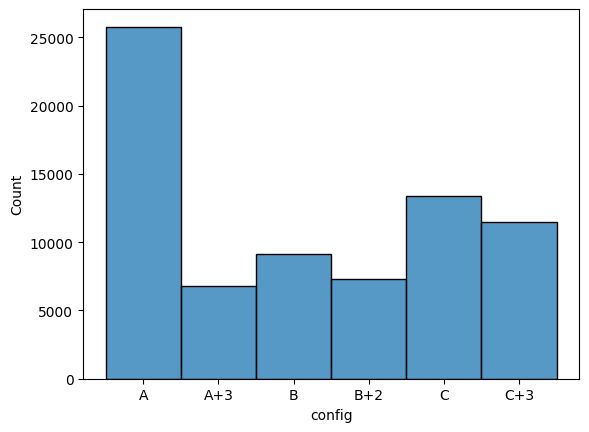

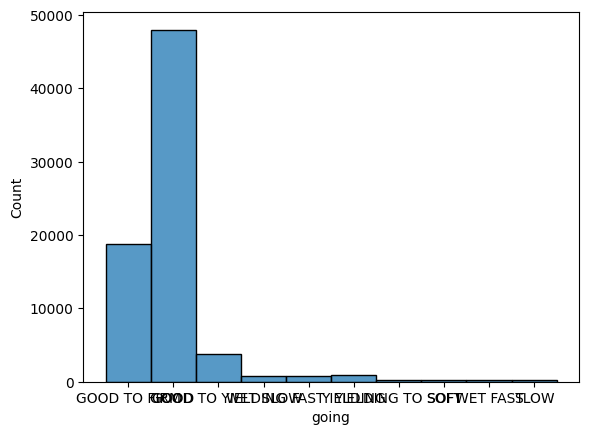

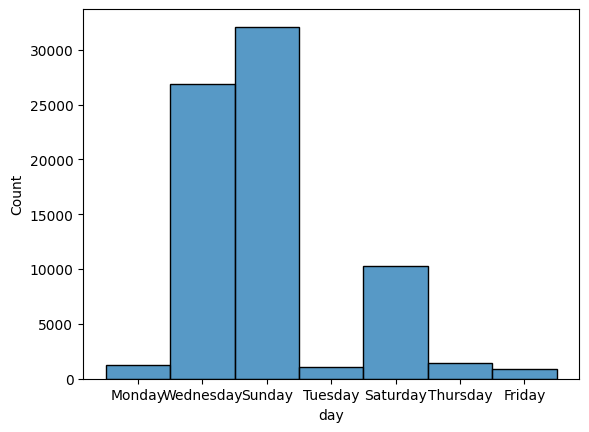

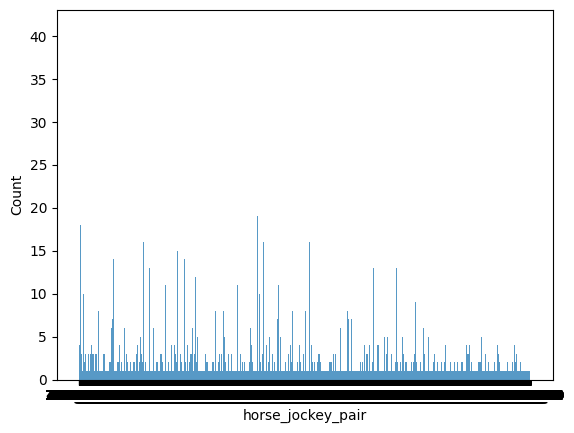

In [28]:
for col in df.select_dtypes('object').columns:
    plt.figure()
    sns.histplot(x=df[col])

In [29]:
px.histogram(df,x=df['horse_country'])

In [30]:
df['horse_country'].value_counts()

horse_country
AUS    27768
NZ     25775
IRE     9715
GB      5693
USA     2307
FR      1163
SAF      657
GER      332
ARG      126
CAN       91
JPN       89
ITY       60
GR        33
BRZ       18
ZIM       12
SPA        2
Name: count, dtype: int64

In [31]:
# Define a threshold for low-frequency categories
threshold = 10000  # You can adjust this based on your dataset
value_counts = df['horse_country'].value_counts()
# Replace low-frequency categories with "Other"
# Replace low-frequency categories with "Other", while handling NaN values
df['horse_country'] = df['horse_country'].apply(
    lambda x: x if pd.notna(x) and value_counts[x] >= threshold else 'Other'
)

In [32]:
px.histogram(df,x=df['horse_country'])

In [33]:
px.histogram(df,x=df['horse_type'])

In [34]:
df['horse_type'].value_counts()

horse_type
Gelding    70069
Brown       1990
Horse       1057
Colt         272
Mare         212
Rig          154
Filly         42
Roan          28
Grey          17
Name: count, dtype: int64

In [35]:
px.histogram(df,x=df['horse_type'],color='won')

In [36]:
from scipy.stats import chi2_contingency
import pandas as pd

# Create a contingency table
contingency_table = pd.crosstab(df['horse_type'], df['won'])

# Perform the chi-square test
chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Value: {chi2}")
print(f"P-Value: {p_value}")

if p_value < 0.05:
    print("There is a significant relationship between horse_type and win.")
else:
    print("There is no significant relationship between horse_type and win.")


Chi-Square Value: 3.4027199391243337
P-Value: 0.906607026133711
There is no significant relationship between horse_type and win.


In [37]:
## This is no relationship between the horse type and the target plus that more than 95% of data is gleding so i see that if i drop this column would be great
df.drop('horse_type',axis=1,inplace=True)

In [38]:
df['horse_gear'].value_counts()

horse_gear
--              55950
B                2851
TT               2448
TT/B             2237
H                1101
                ...  
TT/H-/P-            1
SR-/XB-             1
TT/SB1              1
H-/SR-/B1/E1        1
V-/XB1/B2/H2        1
Name: count, Length: 760, dtype: int64

In [39]:
from scipy.stats import chi2_contingency
import pandas as pd

# Create a contingency table
contingency_table = pd.crosstab(df['horse_gear'], df['won'])

# Perform the chi-square test
chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Value: {chi2}")
print(f"P-Value: {p_value}")

if p_value < 0.05:
    print("There is a significant relationship between horse_gear and win.")
else:
    print("There is no significant relationship between horse_gear and win.")


Chi-Square Value: 871.82588832434
P-Value: 0.002713468037568784
There is a significant relationship between horse_gear and win.


In [40]:
### becouse there is a relationship between horse gear and target so we should keep the column 
df['horse_gear']=df['horse_gear'].apply(lambda x : 'other' if x != '--' else x)

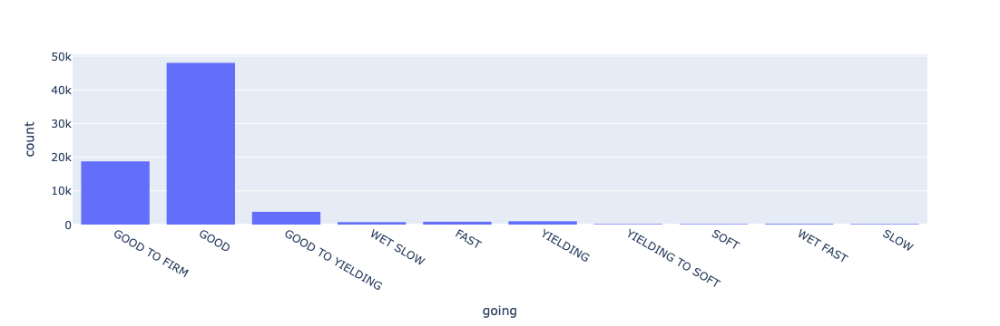

In [41]:
px.histogram(df,x=df['going'])

In [42]:
df['going'].value_counts()

going
GOOD                48010
GOOD TO FIRM        18765
GOOD TO YIELDING     3787
YIELDING              982
FAST                  835
WET SLOW              716
WET FAST              216
SLOW                  186
YIELDING TO SOFT      174
SOFT                  172
Name: count, dtype: int64

In [43]:
from scipy.stats import chi2_contingency
import pandas as pd

# Create a contingency table
contingency_table = pd.crosstab(df['going'], df['won'])

# Perform the chi-square test
chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Value: {chi2}")
print(f"P-Value: {p_value}")

if p_value < 0.05:
    print("There is a significant relationship between going and win.")
else:
    print("There is no significant relationship between going and win.")

Chi-Square Value: 0.3556124768571464
P-Value: 0.9999930356082157
There is no significant relationship between going and win.


In [44]:
### becouse there is no relation between this column and target so i will drop this column
df.drop('going',axis=1,inplace=True)

In [45]:
df.columns

Index(['won', 'horse_age', 'horse_country', 'horse_gear', 'actual_weight',
       'draw', 'trainer_id', 'jockey_id', 'venue', 'config', 'year', 'month',
       'day', 'total_wins', 'win_rate_jockey', 'win_rate_trainer',
       'horse_jockey_pair', 'win_rate', 'avg_finish_position',
       'finish_time_trend'],
      dtype='object')

In [46]:
df.to_csv('Prepocessd_horse_ratings.csv', index=False)